### РОССИЙСКИЙ УНИВЕРСИТЕТ ДРУЖБЫ НАРОДОВ

#### Факультет физико-математических и естественных наук  
#### Кафедра математического моделирования и искусственного интеллекта

## ОТЧЕТ ПО КОНТРОЛЬНОЙ РАБОТЕ № 7


### Дисциплина: Методы машинного обучения

## Москва 2024
***

##### Студент:  Артамонов Т.Е.
##### Группа:   НКНбд-01-21

КР 7, Вариант 24

1. Набор данных: svhn_cropped

2. Диапазон классов: 1, 3, 5, 7, 9

3. Архитектура автокодировщика: MLP

4. Показатель качества: cреднее абсолютное отклонение (MAE) для ошибки реконструкции

5. Показатель качества бинарной классификации:

индекс Фоулкса – Мэллоуса, равный корню квадратному из TP/(TP + TN) * TP/(TP + FP)

### Задание 1. Загрузите заданный в индивидуальном задании набор данных с изображениями из Tensorflow Datasets с разбиением на обучающую и тестовую выборки. Оставьте в обучающей и тестовой выборках диапазон классов, указанных в индивидуальном задании. Если изображения цветные (с тремя каналами), то перекодируйте их в одноцветные (оттенки серого).

### Решение
Импортируем библиотеки

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow.keras as keras
import pandas as pd
import time
import sys
from PIL import Image, ImageOps
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.models import Model
import tensorflow_datasets as tfds
import tensorflow as tf

Загрузим тестовую и обучающую выборки

In [2]:
ds = tfds.load("svhn_cropped", split=["train", "test"])
df_train = pd.DataFrame(ds[0])
df_test = pd.DataFrame(ds[1])
df_train['label'][0]

<tf.Tensor: shape=(), dtype=int64, numpy=4>

Оставим только изображения с метками, указанными в задании

In [3]:
x = df_train[df_train['label'] == 1]
y = df_train[df_train['label'] == 3]
v = df_train[df_train['label'] == 5]
z = df_train[df_train['label'] == 7]
c = df_train[df_train['label'] == 9]
x['label'] = 0
y['label'] = 1
v['label'] = 2
z['label'] = 3
c['label'] = 4

df_tr = pd.concat([x, y, v, z, c])
Y_train = df_tr['label']
X_train = df_tr['image']

x = df_test[df_test['label'] == 1]
y = df_test[df_test['label'] == 3]
v = df_test[df_test['label'] == 5]
z = df_test[df_test['label'] == 7]
c = df_test[df_test['label'] == 9]
x['label'] = 0
y['label'] = 1
v['label'] = 2
z['label'] = 3
c['label'] = 4

df_test = pd.concat([x, y, v, z, c])
Y_test = df_test['label']
X_test = df_test['image']

C:\Users\artam\AppData\Local\Temp\ipykernel_7340\3698640399.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x['label'] = 0
C:\Users\artam\AppData\Local\Temp\ipykernel_7340\3698640399.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y['label'] = 1
C:\Users\artam\AppData\Local\Temp\ipykernel_7340\3698640399.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https

In [4]:
#X_train = np.array(X_train)
import warnings
warnings.simplefilter("ignore", RuntimeWarning)

Перейдем к изображениям с оттенками серого

In [5]:
for i in range(len(X_train)):
  img = Image.fromarray(np.array(X_train.iloc[i]))
  X_train.iloc[i] = np.array(ImageOps.grayscale(img))#,dtype='float32')

for i in range(len(X_test)):
  img = Image.fromarray(np.array(X_test.iloc[i]))
  X_test.iloc[i] = np.array(ImageOps.grayscale(img))#,dtype='float32')

C:\Users\artam\AppData\Local\Temp\ipykernel_7340\3559432100.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train.iloc[i] = np.array(ImageOps.grayscale(img))#,dtype='float32')
C:\Users\artam\AppData\Local\Temp\ipykernel_7340\3559432100.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train.iloc[i] = np.array(ImageOps.grayscale(img))#,dtype='float32')
C:\Users\artam\AppData\Local\Temp\ipykernel_7340\3559432100.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.h

In [6]:
X_tr = np.zeros(shape=(X_train.shape[0],32,32), dtype=np.float32)
X_te  = np.zeros(shape=(X_test.shape[0],32,32), dtype=np.float32)
for i in range(len(X_tr)):
    X_tr[i,:,:] = X_train.iloc[i]
for i in range(len(X_te)):
    X_te[i,:,:] = X_test.iloc[i]
X_tr.shape

(39494, 32, 32)

### Задание 2. Постройте для набора данных график логарифмического правдоподобия профиля в зависимости от числа главных компонент и определите размерность латентного пространства.

### Решение
Напишем функцию

In [7]:
from sklearn.decomposition import PCA
from sklearn.metrics import mean_absolute_error
from scipy.stats import multivariate_normal
import warnings
warnings.simplefilter("ignore", RuntimeWarning)  # for some NaN values

# Function to calculate log likelihood of PCA from eigenvalues

def log_likelihood(evals):

    Lmax = len(evals)
    ll = np.arange(0.0, Lmax)

    for L in range(Lmax):

        group1 = evals[0 : L + 1]  # Divide Eigenvalues in two groups
        group2 = evals[L + 1 : Lmax]

        mu1 = np.mean(group1)
        mu2 = np.mean(group2)

        sigma = (np.sum((group1 - mu1) ** 2) + np.sum((group2 - mu2) ** 2)) / Lmax

        ll_group1 = np.sum(multivariate_normal.logpdf(group1, mu1, sigma))
        ll_group2 = np.sum(multivariate_normal.logpdf(group2, mu2, sigma))

        ll[L] = ll_group1 + ll_group2

    return ll

Изменим размерность массивов изображений

In [8]:
X1 = np.reshape(X_tr, (X_tr.shape[0], 32 * 32))
X2 = np.reshape(X_te, (X_te.shape[0], 32 * 32))

In [9]:
X_rank = np.linalg.matrix_rank(X1)

K_linspace = np.linspace(1, 0.75 * X_rank, 10, dtype=int)

Ks = np.unique(K_linspace)


MAE_train = np.arange(len(Ks))



for index, K in enumerate(Ks):
    pca = PCA(n_components=K)

    Xtrain_transformed = pca.fit_transform(X1)
    Xtrain_proj = pca.inverse_transform(Xtrain_transformed)
    MAE_train[index] = mean_absolute_error(X1, Xtrain_proj)


Размерность латентного пространства 133

In [10]:
X_rank

133

In [11]:
n_samples, n_features = X1.shape
Kmax = min(n_samples, n_features)

pca = PCA(n_components=Kmax)
X_transformed = pca.fit_transform(X1)
evals = pca.explained_variance_  # eigenvalues in descending order

ll = log_likelihood(evals)

# Fraction of variance explained

fraction_var = np.cumsum(evals[0:50] / np.sum(evals))

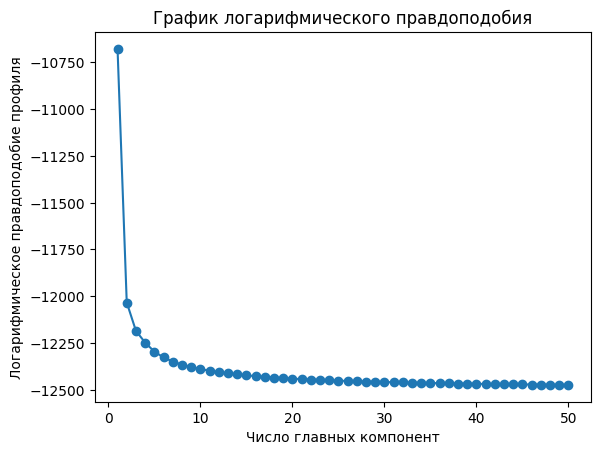

In [12]:
fig, ax = plt.subplots()
xs = np.arange(1, 51)
ys = ll[0:50]
plt.xlabel("Число главных компонент")
plt.ylabel("Логарифмическое правдоподобие профиля")
plt.title("График логарифмического правдоподобия")
ax.plot(xs, ys, marker="o")
plt.show()

In [13]:
X1 = X1.astype('float32') / 255.
X2  = X2.astype('float32') / 255.

In [14]:
X1.shape, X2.shape

((39494, 1024), (13979, 1024))

### Задание 3. Создайте и обучите на обучающей выборке автокодировщик архитектуры, указанной в индивидуальном задании, с размерностью скрытого представления, равной размерности латентного пространства, определенной в п.2. Подберите такие параметры, как функции активации, оптимизатор, начальная скорость обучения, размер мини-пакета и др. самостоятельно, обеспечивая обучение нейронных сетей. Визуализируйте несколько исходных и восстановленных автокодировщиком изображений.

### Решение

Напишем функцию

In [15]:
def create_autoencoders (feature_layer_dim = 133):
    input_img = Input(shape = (1024,), name = 'Input_Layer')
    encoded = Dense(feature_layer_dim, activation = 'leaky_relu', 
                    name = 'Encoded_Features')(input_img)
    decoded = Dense(1024, activation = 'sigmoid', 
                    name = 'Decoded_Input')(encoded)

    autoencoder = Model(input_img, decoded)
    encoder = Model(input_img, encoded)

    encoded_input = Input(shape = (feature_layer_dim,))
    decoder = autoencoder.layers[-1]
    decoder = Model(encoded_input, decoder(encoded_input))

    return autoencoder, encoder, decoder

Создадим автокодировщик и обучим, используем колбэк для своевременной остановки обучения

In [16]:
autoencoder, encoder, decoder = create_autoencoders(133)
autoencoder.compile(optimizer=keras.optimizers.Adam(), loss=keras.losses.binary_crossentropy)
history = autoencoder.fit(X1, X1,
                epochs=50,
                batch_size=128,
                shuffle=True,
                validation_data=(X2, X2),
                verbose = 1,
                callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=2)]);

Epoch 1/50
309/309 [==============================] - 3s 6ms/step - loss: 0.6525 - val_loss: 0.6021
Epoch 2/50
309/309 [==============================] - 2s 5ms/step - loss: 0.6156 - val_loss: 0.5899
Epoch 3/50
309/309 [==============================] - 2s 6ms/step - loss: 0.6122 - val_loss: 0.5886
Epoch 4/50
309/309 [==============================] - 2s 5ms/step - loss: 0.6106 - val_loss: 0.5880
Epoch 5/50
309/309 [==============================] - 2s 5ms/step - loss: 0.6100 - val_loss: 0.5862
Epoch 6/50
309/309 [==============================] - 2s 5ms/step - loss: 0.6093 - val_loss: 0.5855
Epoch 7/50
309/309 [==============================] - 2s 5ms/step - loss: 0.6086 - val_loss: 0.5856
Epoch 8/50
309/309 [==============================] - 2s 5ms/step - loss: 0.6081 - val_loss: 0.5886


Выведем сверху исходные изображения, снизу восстановленные

In [17]:
def plot_sample(images):
    n = 10
    imgs = list(images['label']) + list(images2[0:5])
    num_row = 2
    num_col = 5

    fig, axes = plt.subplots(num_row, num_col, figsize=(3.5 * num_col, 3 * num_row))
    # For every image
    for i in range(num_row * num_col):
        # Read the image
        img = imgs[i]
        # Display the image
        ax = axes[i // num_col, i % num_col]
        ax.imshow(img, cmap='gray')

    plt.tight_layout()
    plt.show()

437/437 [==============================] - 1s 1ms/step


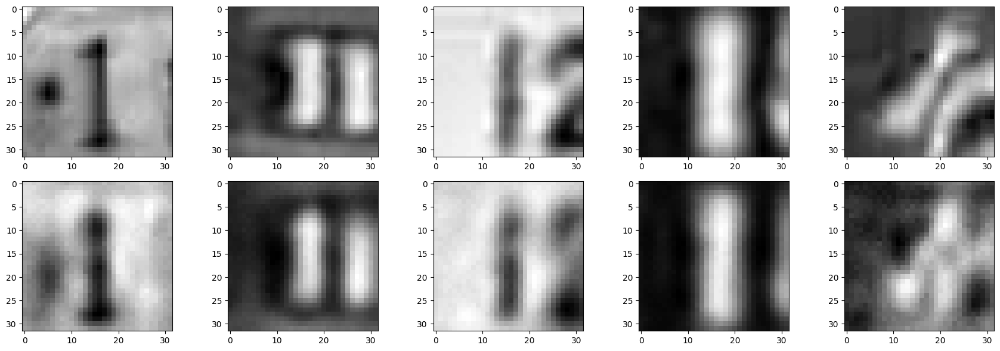

In [18]:
plot_sample(X2.reshape(X2.shape[0], 32, 32), autoencoder.predict(X2).reshape(X2.shape[0], 32, 32))

### Задание 4. Оцените качество модели автокодировщика на тестовой выборке по показателю, указанному в индивидуальном задании.

### Решение

In [19]:
encoded_imgs = encoder.predict(X2)
decoded_imgs = decoder.predict(encoded_imgs)
np.mean(keras.metrics.MAE(decoded_imgs, X2))

437/437 [==============================] - 0s 954us/step


0.050861318

Достаточно хороший результат

### Задание 5. Оставьте в наборах изображения первых двух классов диапазона, указанного в индивидуальном задании первыми. Визуализируйте набор данных на плоскости, соответствующей двум первым латентным признакам, отображая точки различных классов разными цветами. Подпишите оси и рисунок, создайте легенду для классов набора данных.

### Решение
Оставим первые 2 класса

In [21]:
x = df_train[df_train['label']==1]
x['label']=0
y = df_train[df_train['label']==3]
y['label']=1
df_tr = pd.concat([x,y])
x = df_test[df_test['label']==1]
x['label']=0
y = df_test[df_test['label']==3]
y['label']=1

df_te = pd.concat([x,y])
X_train, Y_train = df_tr['image'], np.array(df_tr['label'])
X_test, Y_test = df_te['image'], np.array(df_te['label'])
for i in range(len(X_train)):
  img = Image.fromarray(np.array(X_train.iloc[i]))
  X_train.iloc[i] = np.array(ImageOps.grayscale(img))#,dtype='float32')

for i in range(len(X_test)):
  img = Image.fromarray(np.array(X_test.iloc[i]))
  X_test.iloc[i] = np.array(ImageOps.grayscale(img))#,dtype='float32')
X_tr = np.zeros(shape=(X_train.shape[0],32,32), dtype=np.float32)
X_te  = np.zeros(shape=(X_test.shape[0],32,32), dtype=np.float32)
for i in range(len(X_tr)):
    X_tr[i,:,:] = X_train.iloc[i]
for i in range(len(X_te)):
    X_te[i,:,:] = X_test.iloc[i]

X_tr = X_tr.reshape(X_tr.shape[0], 32*32)
X_te = X_te.reshape(X_te.shape[0], 32*32)
X_tr = X_tr.astype('float32') / 255.
X_te  = X_te.astype('float32') / 255.

C:\Users\artam\AppData\Local\Temp\ipykernel_7340\2337409198.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x['label']=0
C:\Users\artam\AppData\Local\Temp\ipykernel_7340\2337409198.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y['label']=1
C:\Users\artam\AppData\Local\Temp\ipykernel_7340\2337409198.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://p

266/266 [==============================] - 0s 947us/step


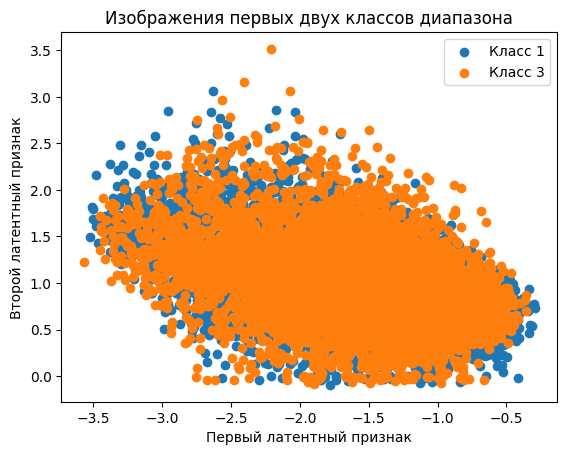

In [23]:
zxc = pd.concat([pd.DataFrame(X_tr),pd.DataFrame(Y_train)],axis=1)
zxc0 = zxc[zxc.iloc[:,1024] == 0]
zxc1 = zxc[zxc.iloc[:,1024] == 1]
e0 = encoder.predict(zxc0.iloc[:,:1024])
e1 = encoder.predict(zxc1.iloc[:,:1024])
plt.scatter(e0[:,0], e0[:,1], label='Класс 1')
plt.scatter(e1[:,0], e1[:,1], label='Класс 3')
plt.xlabel('Первый латентный признак')
plt.ylabel('Второй латентный признак')
plt.title('Изображения первых двух классов диапазона')
plt.legend();

### Задание 6. Выполните бинарную классификацию изображений по латентным (скрытым) признакам и всем признакам при помощи классификатора метода ближайших соседей (KNN). Оцените бинарный классификатор, указанный в индивидуальном задании, для двух построенных классификаторов.

### Решение

In [24]:
# импорт необходимых библиотек 
from sklearn import datasets 
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split 
import seaborn as sns

Классификация по скрытым признакам

In [25]:
from sklearn.neighbors import KNeighborsClassifier 

encoded_imgs = encoder.predict(X_tr)
decoded_imgs = decoder.predict(encoded_imgs)

knn1 = KNeighborsClassifier(n_neighbors=7).fit(encoded_imgs, Y_train) 

accuracy = knn1.score(encoder.predict(X_te), Y_test) 
print(accuracy)

154/154 [==============================] - 0s 1ms/step
0.3717608651295654


Классификация по всем признакам

In [26]:
knn2 = KNeighborsClassifier(n_neighbors=7).fit(X_tr, Y_train) 

accuracy = knn2.score(X_te, Y_test) 
print(accuracy)

0.3701285451948582


Разница небольшая

Напишем функцию оценки качества

In [27]:
def fm(y_true, y_predict):
    assert len(y_true) == len(y_predict)
    tp = np.sum((y_true == 0) & (y_predict == 0))
    fp = np.sum((y_true == 0) & (y_predict == 1))
    tn = np.sum((y_true == 1) & (y_predict == 1))
    return tp/(tp + tn) * tp/(tp + fp)

Сравним разные способы

In [28]:
fm(knn1.predict(encoder.predict(X_te)), Y_test), fm(knn2.predict(X_te), Y_test)

154/154 [==============================] - 0s 974us/step


(0.29641673321000295, 0.3332331265572388)

Отличия минимальные

### 7. Визуализируйте ROC-кривые для построенных классификаторов на одном рисунке (с легендой) (Указание: используйте метод predict_proba() класса KNeighborsClassifier).

### Решение
Напишем необходимые функции

In [29]:
def true_false_positive(threshold_vector, y_test):
    true_positive = np.equal(threshold_vector, 1) & np.equal(y_test, 1)
    true_negative = np.equal(threshold_vector, 0) & np.equal(y_test, 0)
    false_positive = np.equal(threshold_vector, 1) & np.equal(y_test, 0)
    false_negative = np.equal(threshold_vector, 0) & np.equal(y_test, 1)

    tpr = true_positive.sum() / (true_positive.sum() + false_negative.sum())
    fpr = false_positive.sum() / (false_positive.sum() + true_negative.sum())

    return tpr, fpr
def roc_from_scratch(probabilities, y_test, partitions=100):
    roc = np.array([])
    for i in range(partitions + 1):

        threshold_vector = np.greater_equal(probabilities, i / partitions).astype(int)
        tpr, fpr = true_false_positive(threshold_vector, y_test)
        roc = np.append(roc, [fpr, tpr])

    return roc.reshape(-1, 2)

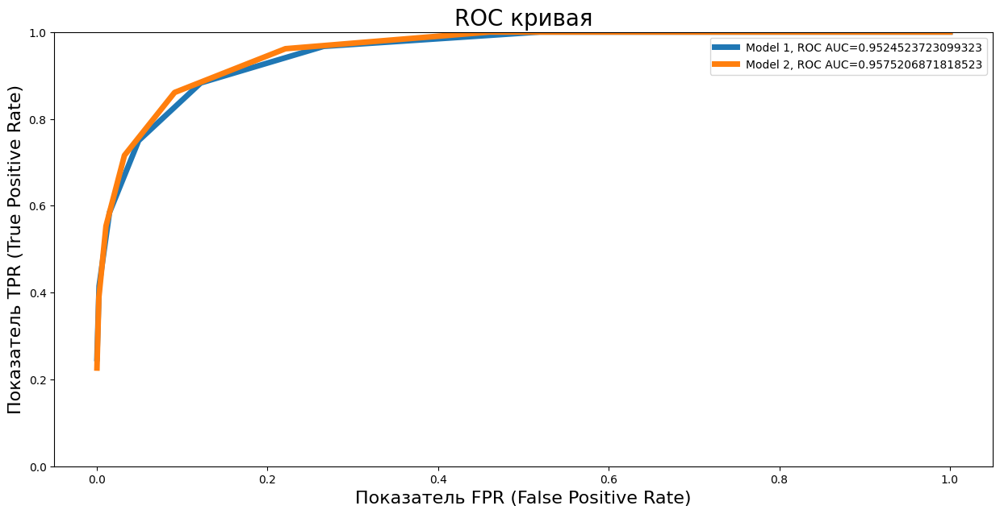

In [30]:
from sklearn.metrics import roc_auc_score
plt.figure(figsize=(15,7))
m1 = np.array([i[1] for i in knn1.predict_proba(encoded_imgs)])
m2 = np.array([i[1] for i in knn2.predict_proba(X_tr)])
r1 = roc_auc_score(Y_train, m1)
r2 = roc_auc_score(Y_train, m2)
ROC1 = roc_from_scratch(m1.reshape(-1),Y_train,partitions=50)
plt.plot(ROC1[:,0],ROC1[:,1],lw=5, label='Model 1, ROC AUC=' + str(r1))

ROC2 = roc_from_scratch(m2.reshape(-1),Y_train,partitions=50)
plt.plot(ROC2[:,0],ROC2[:,1],lw=5, label='Model 2, ROC AUC=' + str(r2))

plt.title('ROC кривая',fontsize=20)
plt.xlabel('Показатель FPR (False Positive Rate)',fontsize=16)
plt.ylabel('Показатель TPR (True Positive Rate)',fontsize=16)
plt.ylim(0,1);
plt.legend();

### Задание 8. Визуализируйте границы принятия решений классификатора KNN для латентных признаков на плоскости, соответствующей двум первым латентным признакам (для прочих латентных признаков задайте средние/медианные значения).

### Решение
Напишем функцию для визуализации

In [31]:
def plot_decision_boundary(model, X, y):
    x_min, x_max = X[:, 0].min() - 0.1, X[:, 0].max() + 0.1
    y_min, y_max = X[:, 1].min() - 0.1, X[:, 1].max() + 0.1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100),
                         np.linspace(y_min, y_max, 100))
    X_in = np.c_[xx.ravel(), yy.ravel()]
    X_in = np.concatenate((X_in, X[:10000,2:]), axis=1)
    y_pred = model.predict(X_in)   
    y_pred = np.round(y_pred).reshape(xx.shape)
    plt.contourf(xx, yy, y_pred, cmap=plt.cm.RdYlBu, alpha=0.7)
    plt.scatter(X[:, 0], X[:, 1], c=y, s=40, cmap=plt.cm.RdYlBu)
    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())

In [32]:
X = encoded_imgs
X = pd.DataFrame(X)
x = X.median()
for i in range(2, 133):
    X.loc[:, i] = x[i]

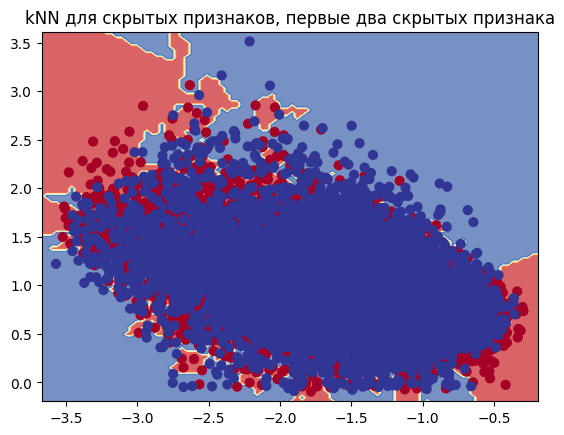

In [33]:
plt.title("kNN для скрытых признаков, первые два скрытых признака")
plot_decision_boundary(model=knn1, X=np.array(X), y=Y_train)

### Задание 9. Определите на первоначальной тестовой выборке изображение, имеющее наибольшую ошибку реконструкции. Выведите для этого изображения первоначальное и реконструированное изображения.

### Решение

In [34]:
X = X2.reshape(X2.shape[0], 32, 32)
X = X.astype('float32') / 255.
encoded_imgs = encoder.predict(X2)
decoded_imgs = decoder.predict(encoded_imgs)

437/437 [==============================] - 0s 912us/step


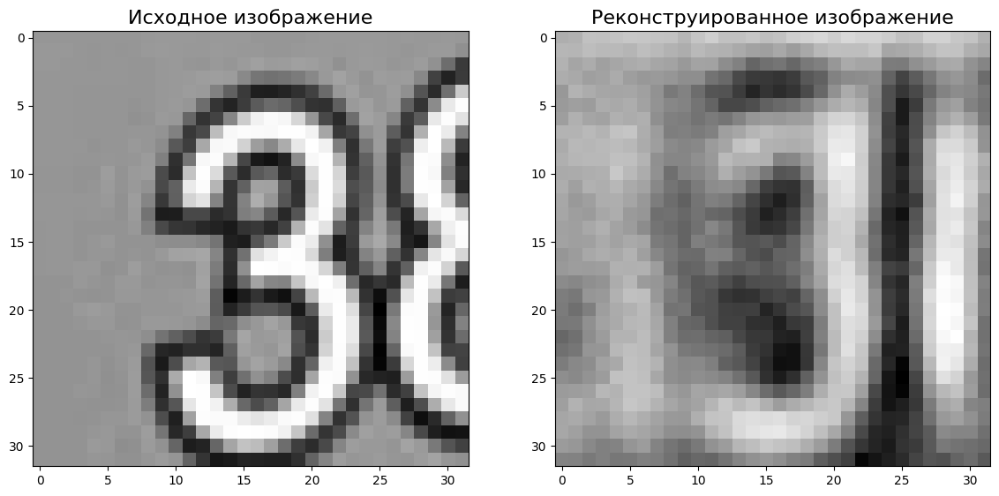

In [35]:
RE = ((X2 - decoded_imgs)**2).mean(axis = 1)
RE_original = RE.copy()
biggest_re_pos = np.argmax(RE_original)
fig = plt.figure(figsize = (14, 7))

ax = fig.add_subplot(1, 2, 1)
plt.title('Исходное изображение', fontsize = 16)
plt.imshow(X2[biggest_re_pos].reshape(32, 32),cmap='gray');

ax = fig.add_subplot(1, 2, 2)
plt.title('Реконструированное изображение', fontsize = 16)
plt.imshow(decoded_imgs[biggest_re_pos].reshape(32, 32),cmap='gray');